# Creating Disparsity Map and Depth Map of the Image


Scene: artroom1
  Left Image: data/artroom1/im0.png
  Right Image: data/artroom1/im1.png


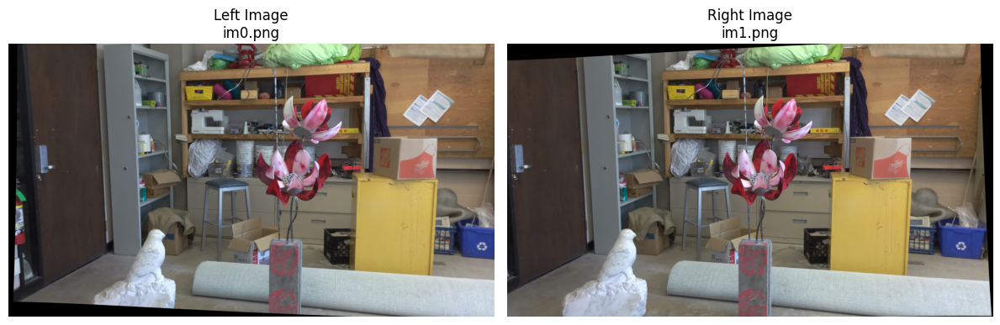

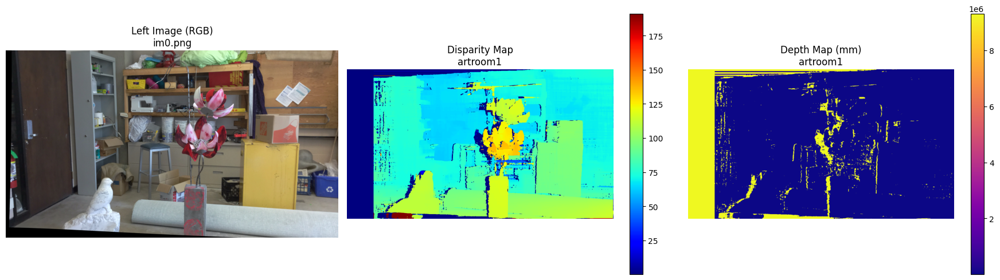


Scene: artroom2
  Left Image: data/artroom2/im0.png
  Right Image: data/artroom2/im1.png


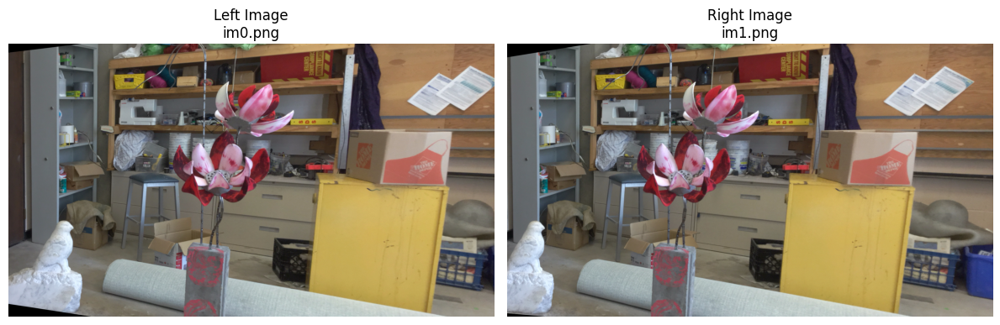

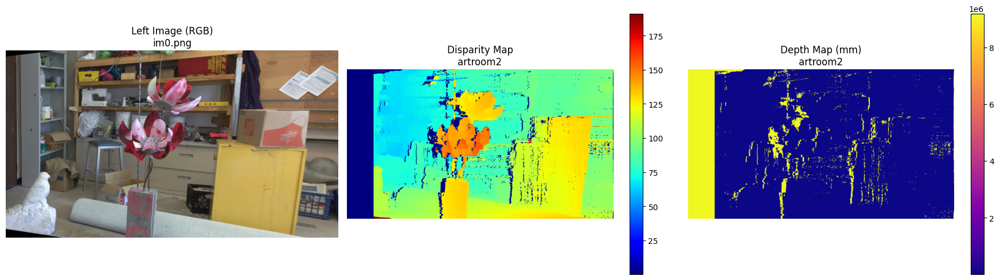


Scene: bandsaw1
  Left Image: data/bandsaw1/im0.png
  Right Image: data/bandsaw1/im1.png


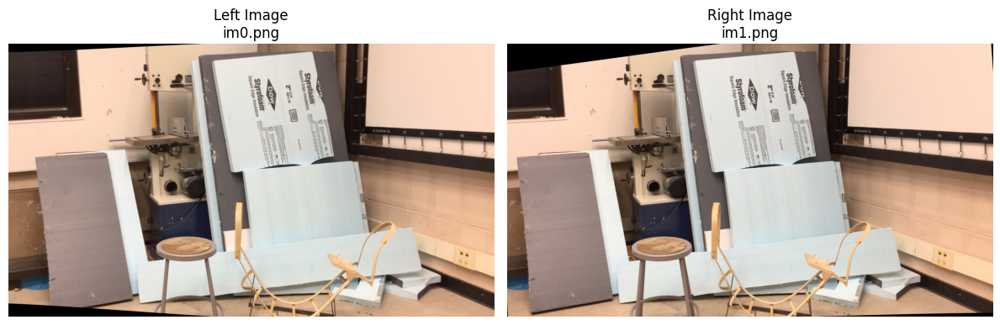

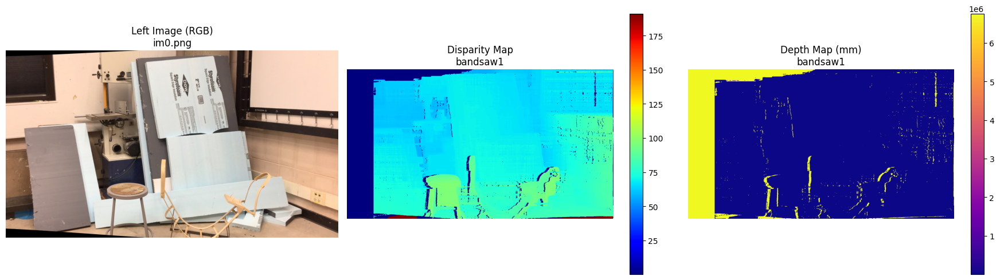


Scene: bandsaw2
  Left Image: data/bandsaw2/im0.png
  Right Image: data/bandsaw2/im1.png


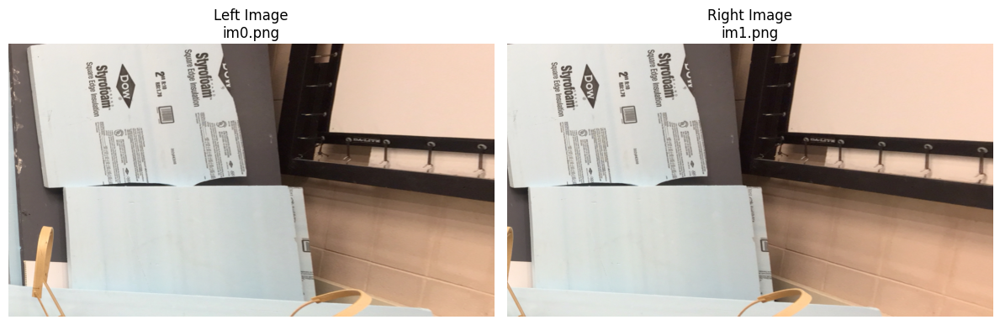

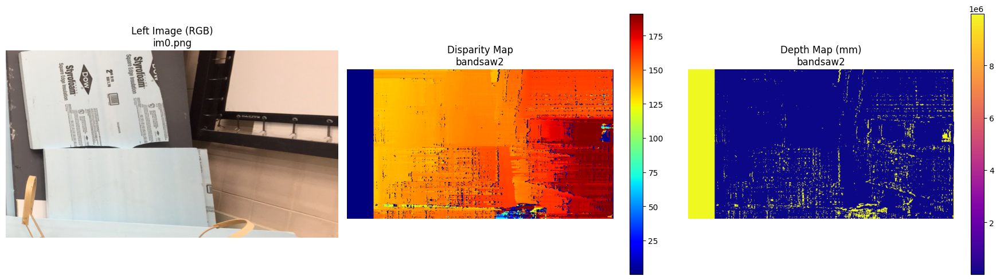


Scene: chess1
  Left Image: data/chess1/im0.png
  Right Image: data/chess1/im1.png


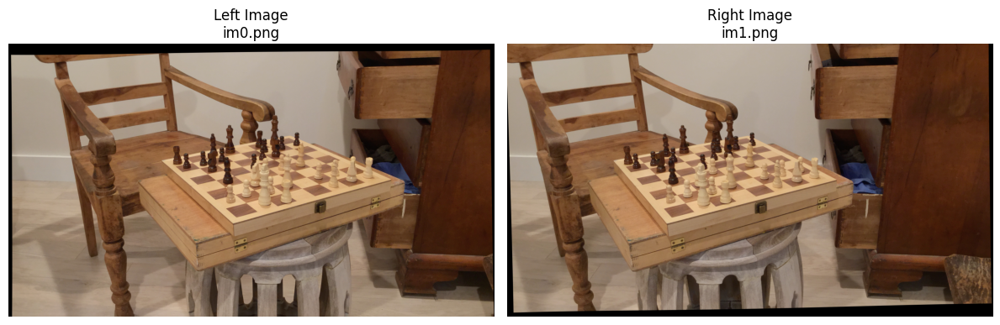

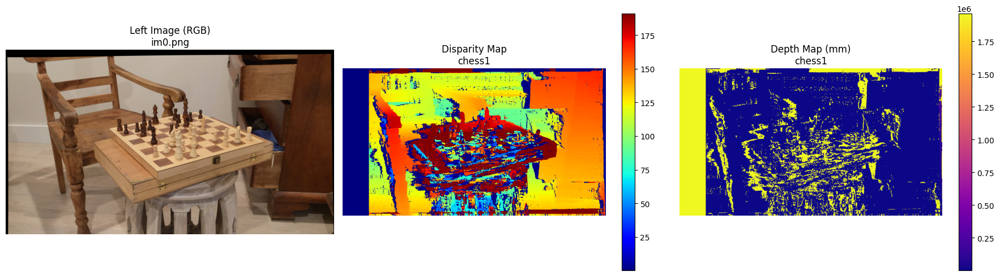


Scene: chess2
  Left Image: data/chess2/im0.png
  Right Image: data/chess2/im1.png


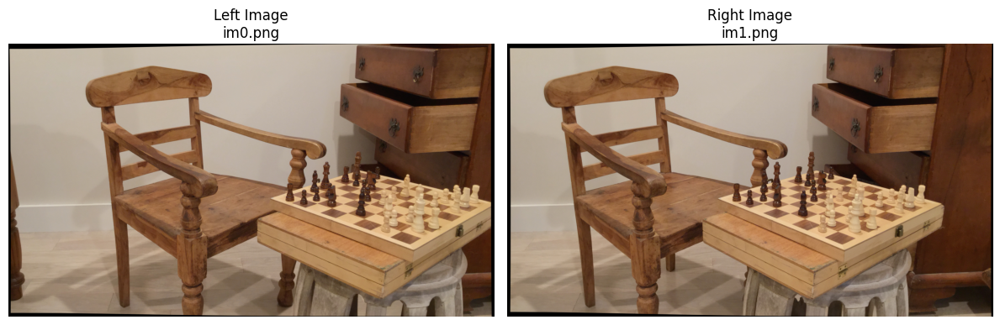

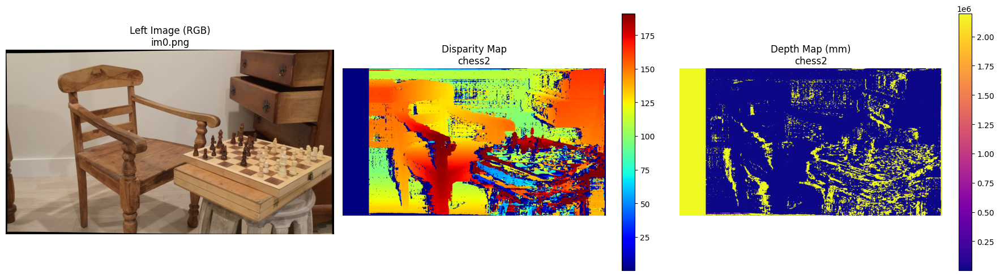


Scene: chess3
  Left Image: data/chess3/im0.png
  Right Image: data/chess3/im1.png


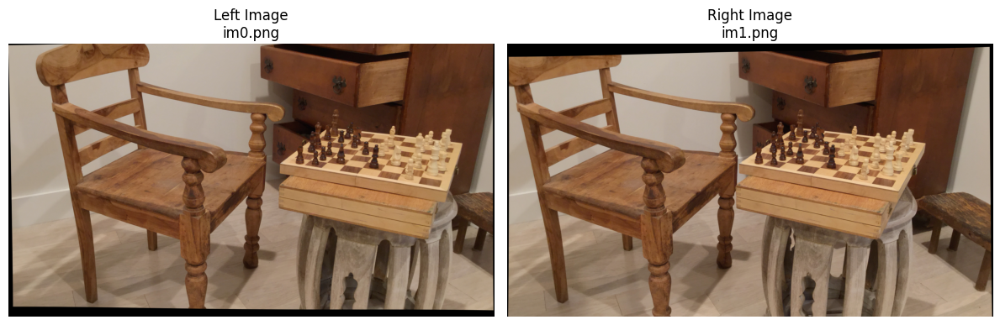

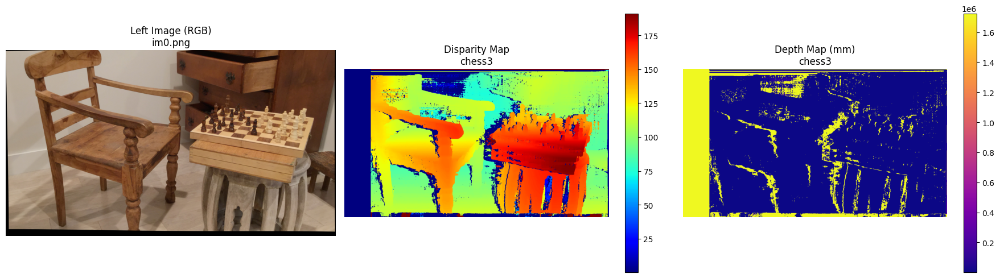


Scene: curule1
  Left Image: data/curule1/im0.png
  Right Image: data/curule1/im1.png


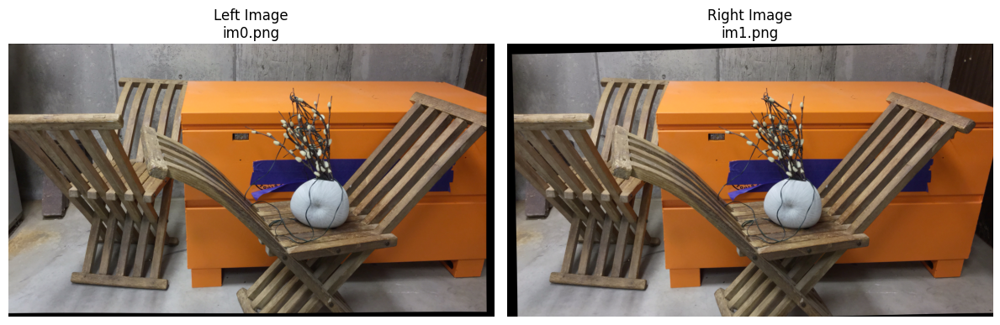

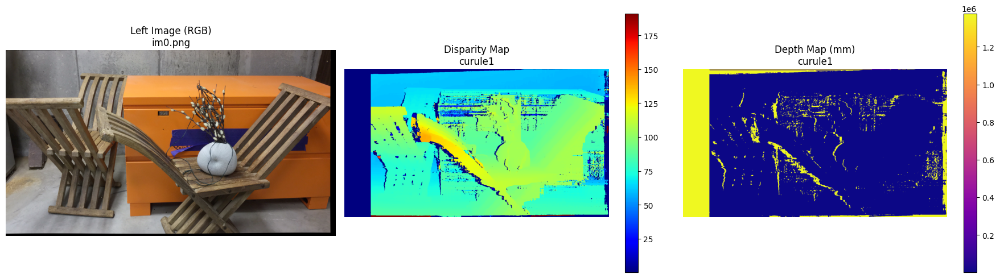


Scene: curule2
  Left Image: data/curule2/im0.png
  Right Image: data/curule2/im1.png


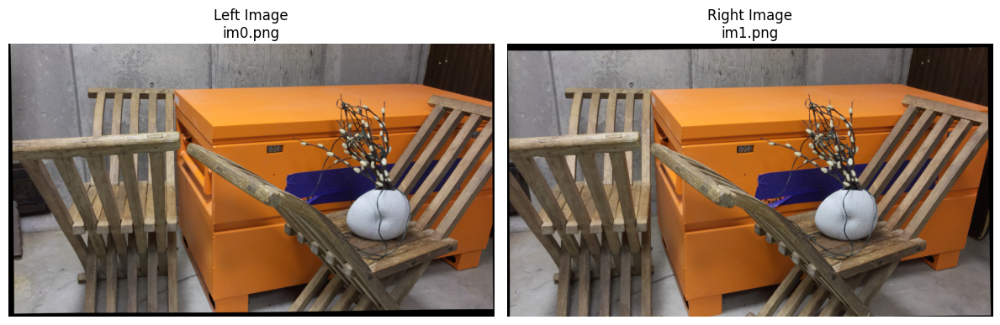

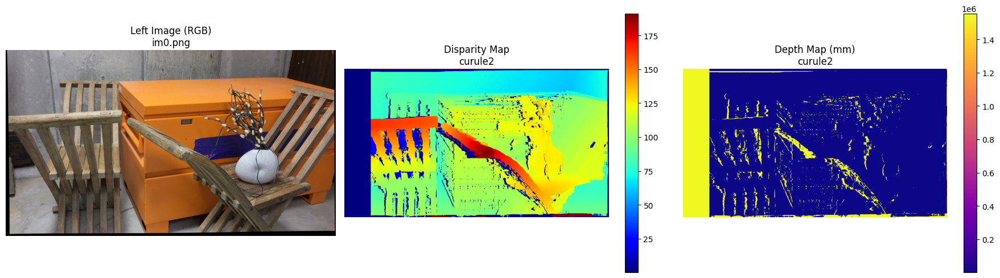


Scene: curule3
  Left Image: data/curule3/im0.png
  Right Image: data/curule3/im1.png


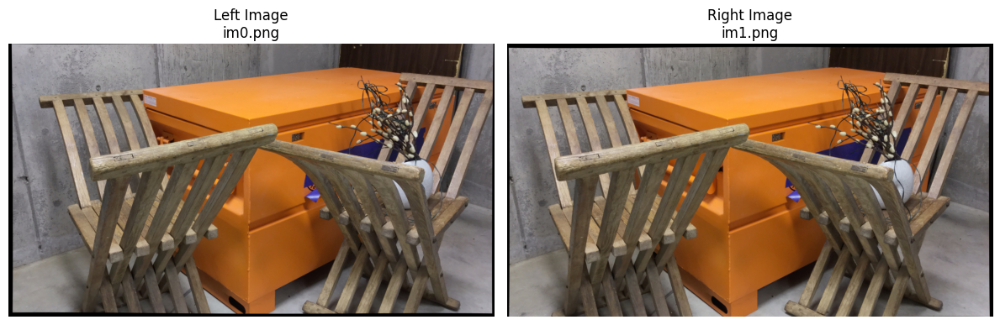

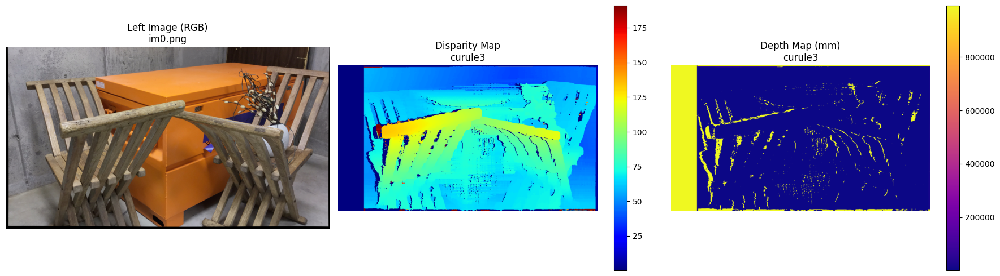


Scene: ladder1
  Left Image: data/ladder1/im0.png
  Right Image: data/ladder1/im1.png


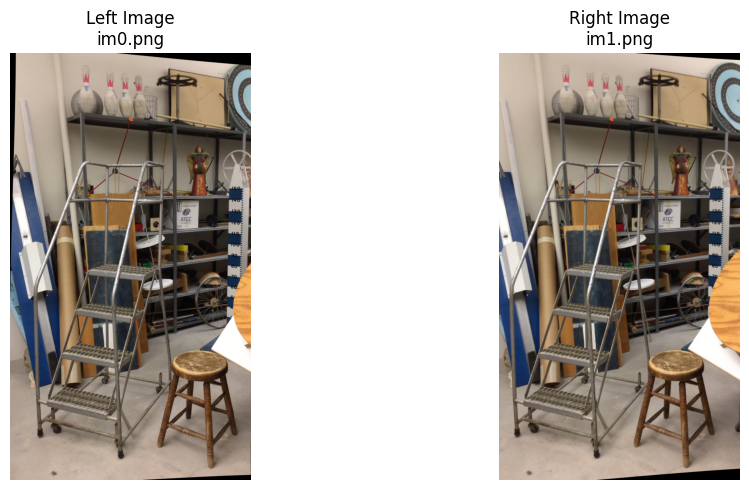

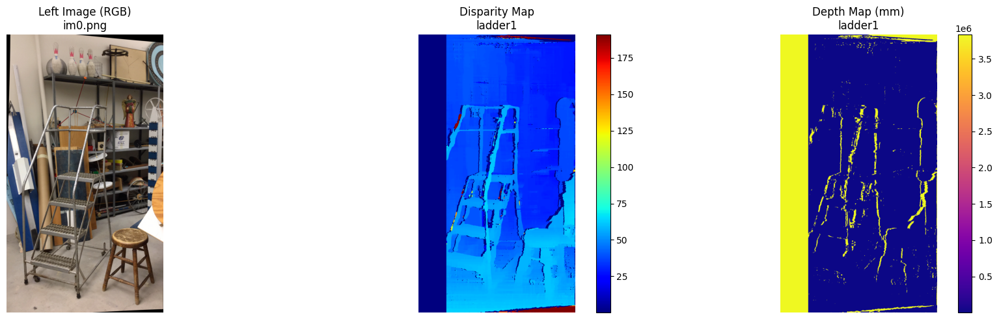


Scene: ladder2
  Left Image: data/ladder2/im0.png
  Right Image: data/ladder2/im1.png


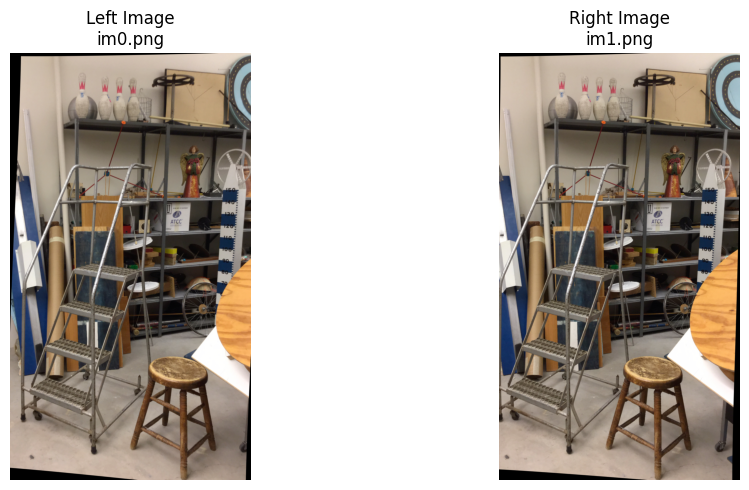

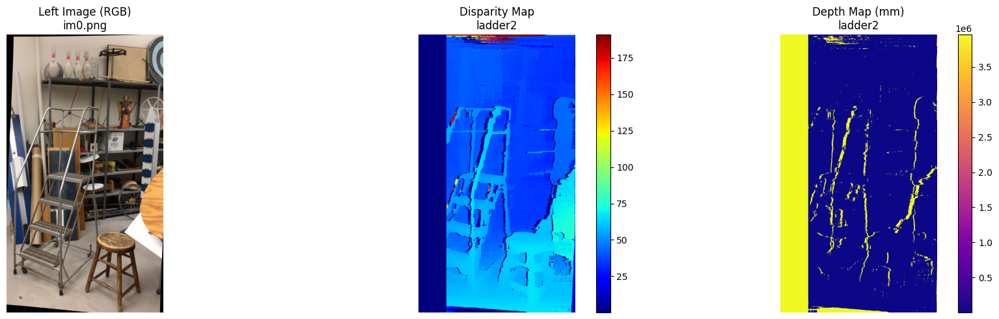


Scene: octogons1
  Left Image: data/octogons1/im0.png
  Right Image: data/octogons1/im1.png


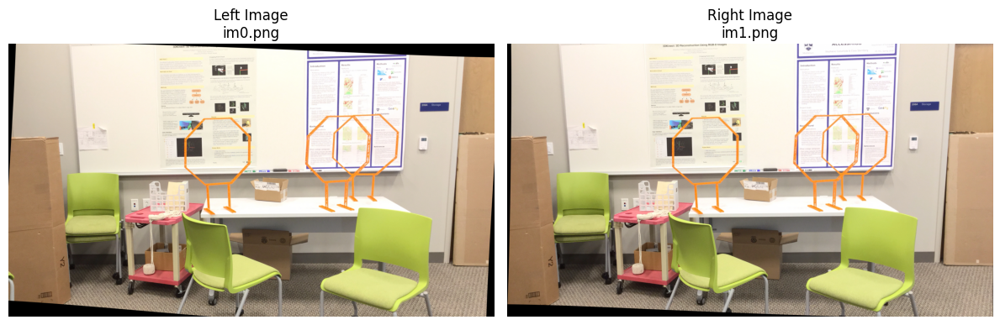

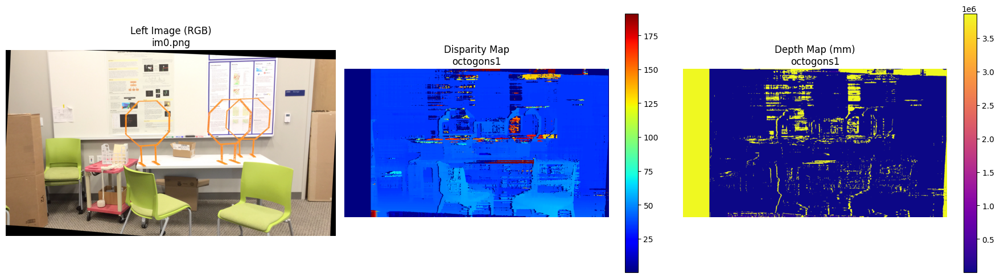


Scene: octogons2
  Left Image: data/octogons2/im0.png
  Right Image: data/octogons2/im1.png


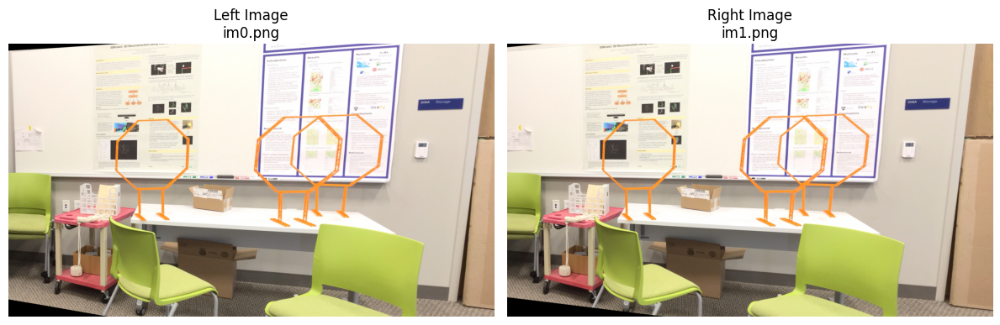

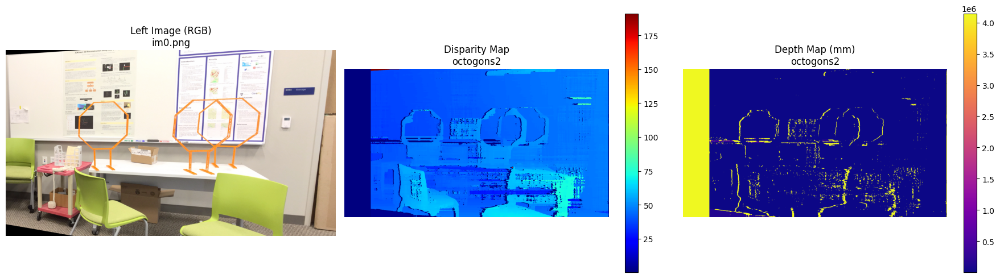


Scene: pendulum1
  Left Image: data/pendulum1/im0.png
  Right Image: data/pendulum1/im1.png


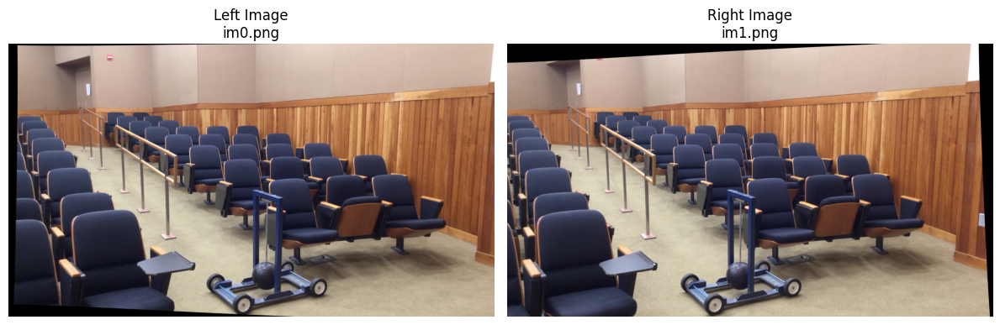

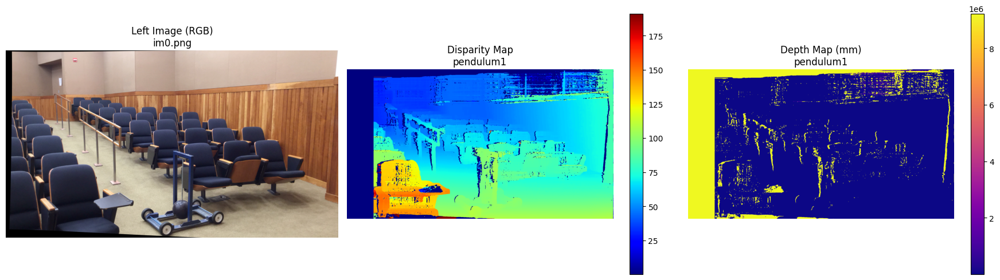


Scene: pendulum2
  Left Image: data/pendulum2/im0.png
  Right Image: data/pendulum2/im1.png


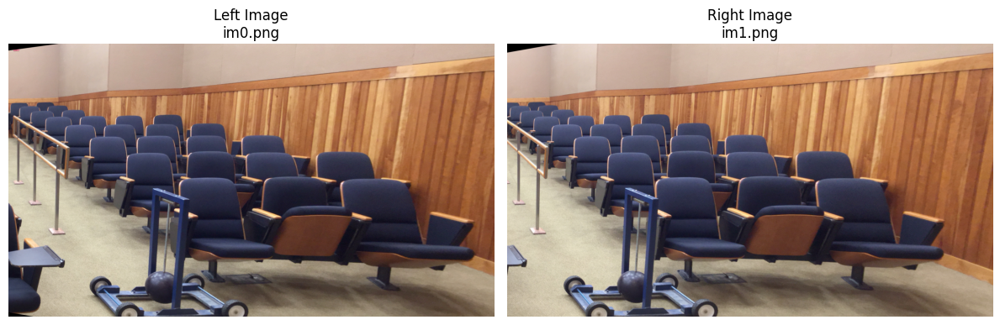

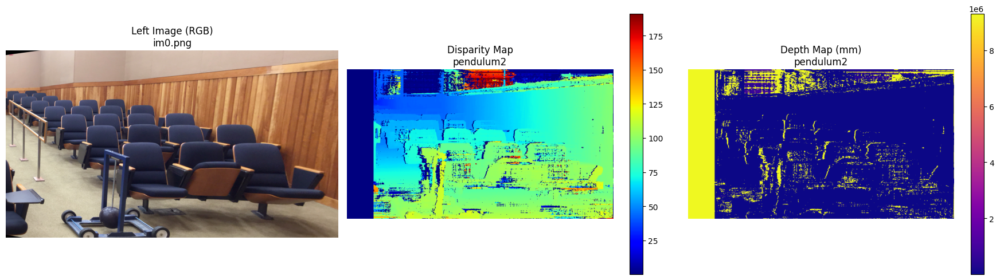


Scene: podium1
  Left Image: data/podium1/im0.png
  Right Image: data/podium1/im1.png


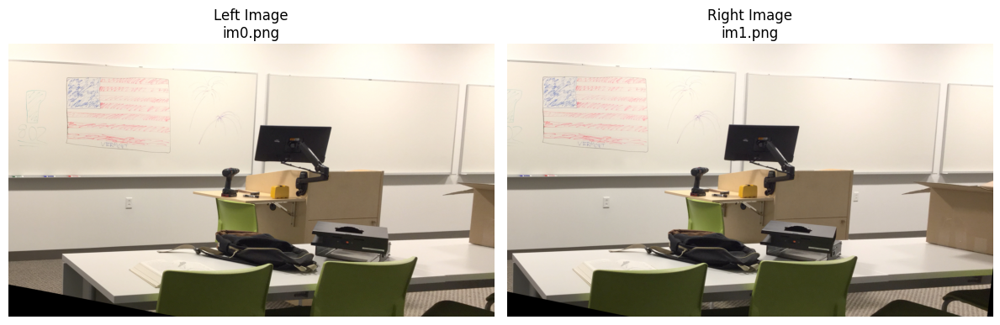

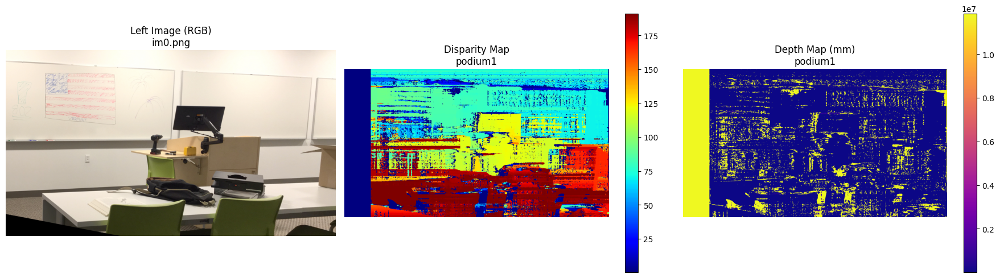


Scene: skates1
  Left Image: data/skates1/im0.png
  Right Image: data/skates1/im1.png


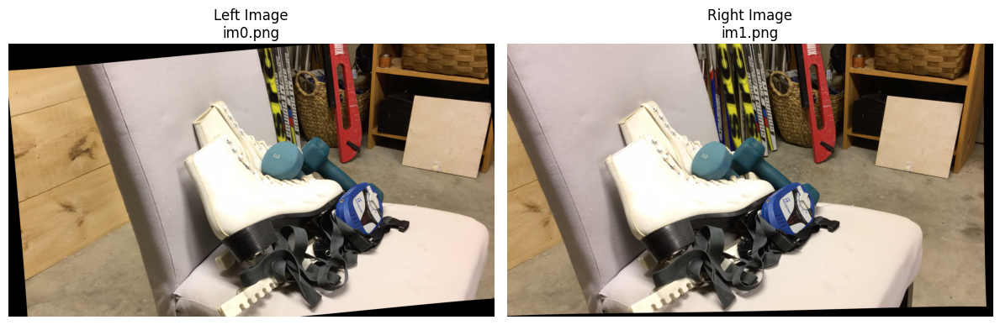

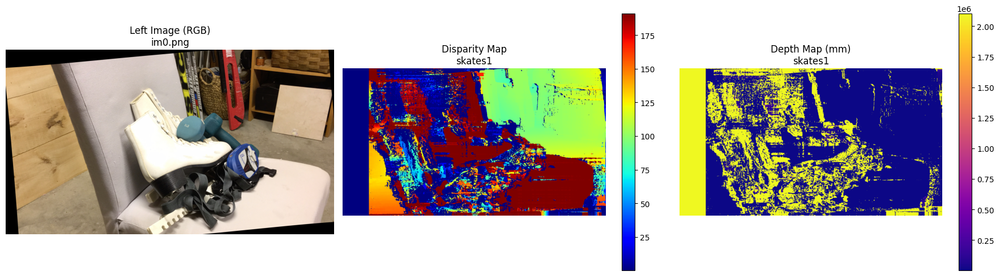


Scene: skates2
  Left Image: data/skates2/im0.png
  Right Image: data/skates2/im1.png


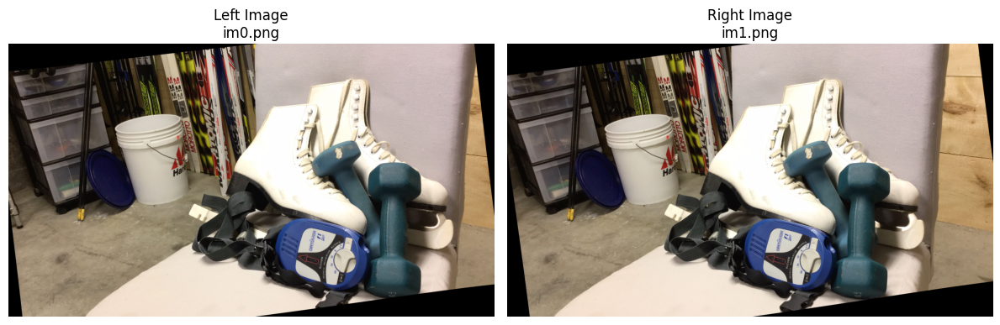

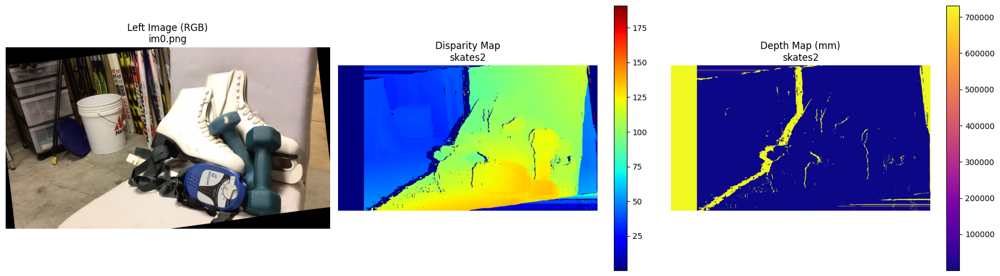


Scene: skiboots1
  Left Image: data/skiboots1/im0.png
  Right Image: data/skiboots1/im1.png


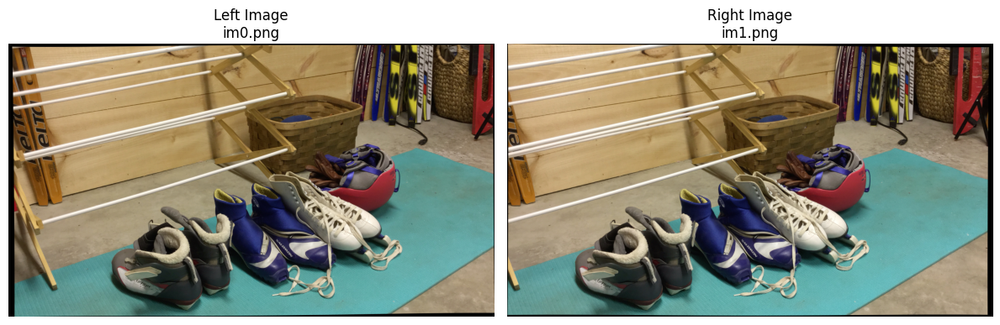

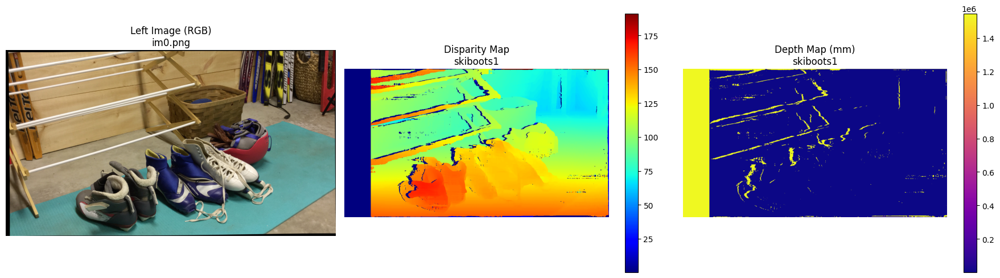


Scene: skiboots2
  Left Image: data/skiboots2/im0.png
  Right Image: data/skiboots2/im1.png


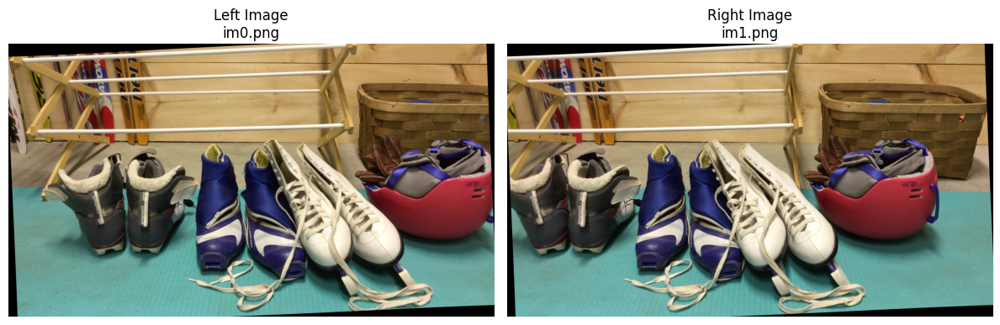

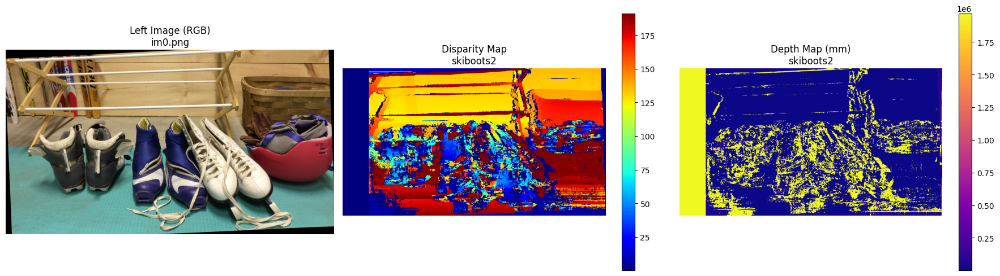


Scene: skiboots3
  Left Image: data/skiboots3/im0.png
  Right Image: data/skiboots3/im1.png


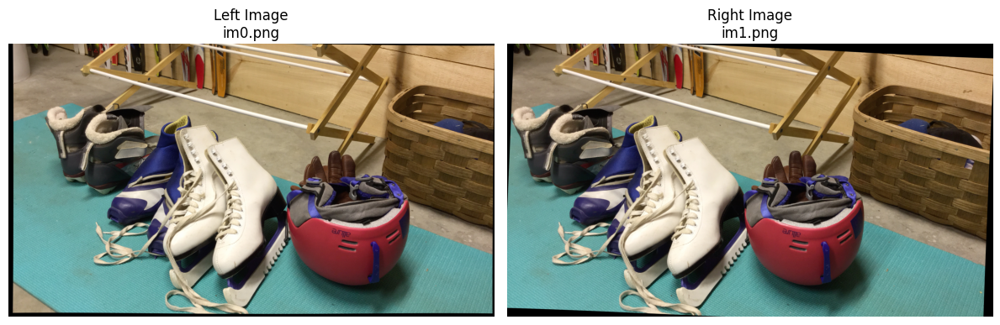

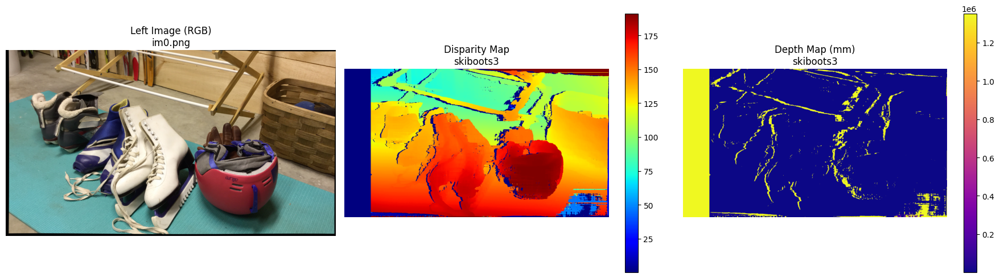


Scene: traproom1
  Left Image: data/traproom1/im0.png
  Right Image: data/traproom1/im1.png


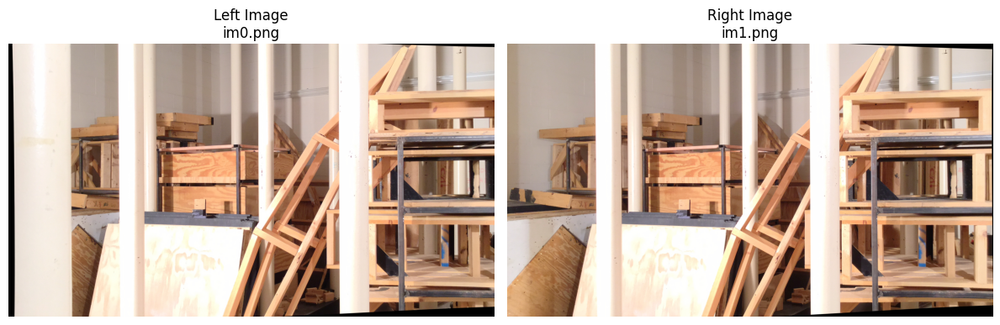

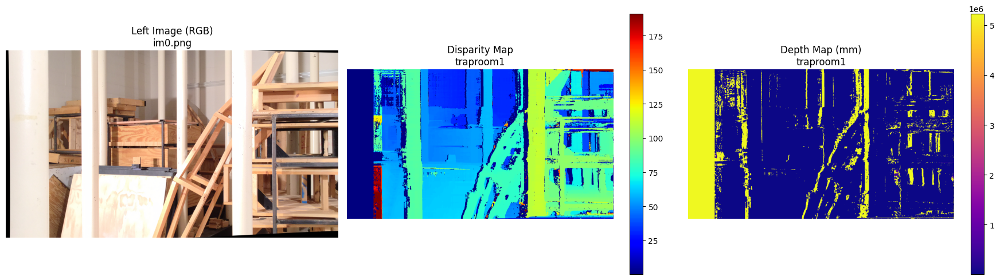


Scene: traproom2
  Left Image: data/traproom2/im0.png
  Right Image: data/traproom2/im1.png


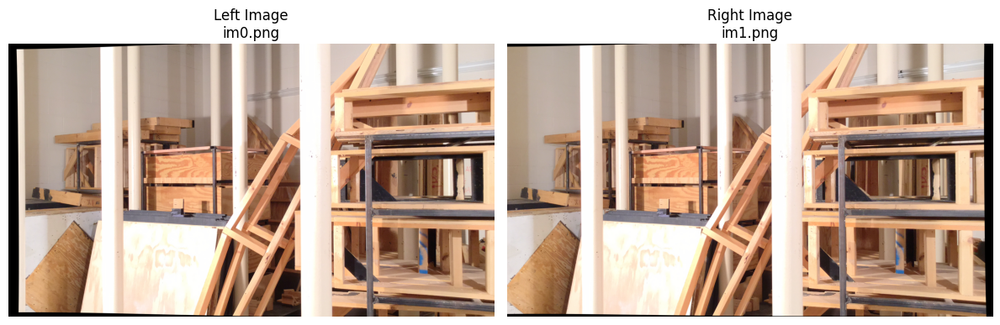

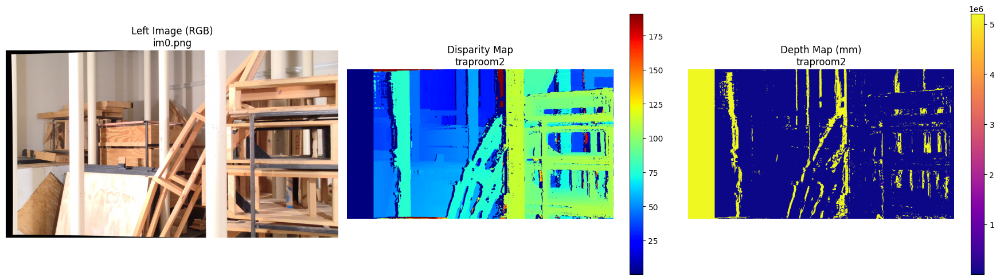

In [7]:
import os
import glob
import numpy as np
import cv2
import matplotlib.pyplot as plt

# dataset used: https://vision.middlebury.edu/stereo/data/scenes2021/
base_dir = "data/"


scene_dirs = sorted([d for d in glob.glob(os.path.join(base_dir, "*")) if os.path.isdir(d)])

for scene_path in scene_dirs:
    scene_name = os.path.basename(scene_path)
    left_img_path = os.path.join(scene_path, "im0.png")
    right_img_path = os.path.join(scene_path, "im1.png")
    calib_file_path = os.path.join(scene_path, "calib.txt")

    print(f"\nScene: {scene_name}")
    print(f"  Left Image: {left_img_path}")
    print(f"  Right Image: {right_img_path}")

    if not (os.path.exists(left_img_path) and os.path.exists(right_img_path) and os.path.exists(calib_file_path)):
        print("files not found, skipping")
        continue

    # read calibration files
    with open(calib_file_path, "r") as f:
        lines = f.readlines()
        params = {}
        for line in lines:
            if "=" in line:
                key, value = line.strip().split("=")
                params[key.strip()] = value.strip()

    try:
        baseline = float(params["baseline"])           
        cam0_values = params["cam0"].replace('[','').replace(']','').split()
        fx = float(cam0_values[0])                    
    except Exception as e:
        print("Calibration file not found", e)
        continue

 
    imgL = cv2.imread(left_img_path, cv2.IMREAD_COLOR)
    imgR = cv2.imread(right_img_path, cv2.IMREAD_COLOR)
    if imgL is None or imgR is None:
        print("Couldn't read images, skipping")
        continue

    # OpenCV'de BGR -> RGB
    imgL_rgb = cv2.cvtColor(imgL, cv2.COLOR_BGR2RGB)
    imgR_rgb = cv2.cvtColor(imgR, cv2.COLOR_BGR2RGB)


    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.title(f"Left Image\n{os.path.basename(left_img_path)}")
    plt.imshow(imgL_rgb)
    plt.axis("off")
    plt.subplot(1, 2, 2)
    plt.title(f"Right Image\n{os.path.basename(right_img_path)}")
    plt.imshow(imgR_rgb)
    plt.axis("off")
    plt.tight_layout()
    plt.show()


    imgL_gray = cv2.cvtColor(imgL_rgb, cv2.COLOR_RGB2GRAY)
    imgR_gray = cv2.cvtColor(imgR_rgb, cv2.COLOR_RGB2GRAY)

    min_disp = 0
    num_disp = 192  # 16'nın katı olmalı
    window_size = 9
    stereo = cv2.StereoSGBM_create(
        minDisparity=min_disp,
        numDisparities=num_disp,
        blockSize=window_size,
        P1=8*3*window_size**2,
        P2=32*3*window_size**2,
        mode=cv2.STEREO_SGBM_MODE_SGBM_3WAY
    )
    disparity = stereo.compute(imgL_gray, imgR_gray).astype(np.float32) / 16.0
    disparity[disparity <= 0] = 0.1

    # Derinlik Hesabı (Depth)
    depth = (baseline * fx) / disparity 

    # visualize
    plt.figure(figsize=(18,5))
    plt.subplot(1,3,1)
    plt.title(f"Left Image (RGB)\n{os.path.basename(left_img_path)}")
    plt.imshow(imgL_rgb)
    plt.axis("off")

    plt.subplot(1,3,2)
    plt.title(f"Disparity Map\n{scene_name}")
    plt.imshow(disparity, cmap="jet")
    plt.colorbar()
    plt.axis("off")

    plt.subplot(1,3,3)
    plt.title(f"Depth Map (mm)\n{scene_name}")
    plt.imshow(depth, cmap="plasma")
    plt.colorbar()
    plt.axis("off")

    plt.tight_layout()
    plt.show()



# Finding Distance (from 3 points with compatible disparsity values)

artroom1 - 3 trusted points and their distances (meter):
  Obje 1: (1848,329) point's distance: 13.16 m
  Obje 2: (1307,142) point's distance: 12.94 m
  Obje 3: (1864,377) point's distance: 13.27 m


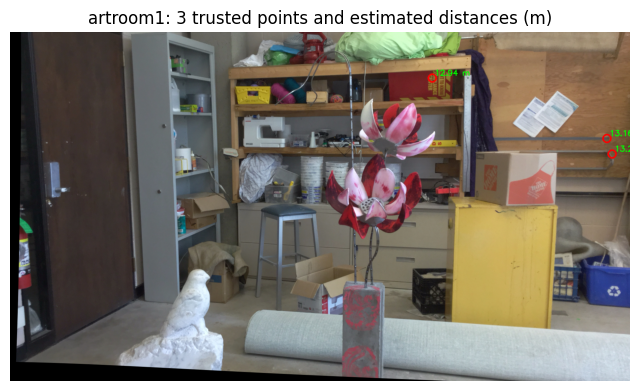

artroom2 - 3 trusted points and their distances (meter):
  Obje 1: (1640,201) point's distance: 10.03 m
  Obje 2: (1838,496) point's distance: 9.97 m
  Obje 3: (301,67) point's distance: 14.03 m


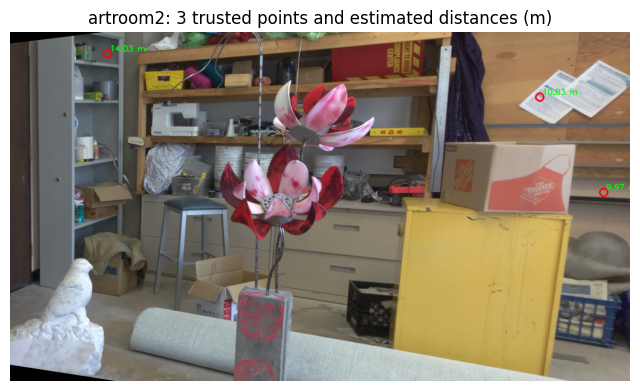

bandsaw1 - 3 trusted points and their distances (meter):
  Obje 1: (1584,644) point's distance: 9.52 m
  Obje 2: (360,899) point's distance: 9.12 m
  Obje 3: (829,1043) point's distance: 7.67 m


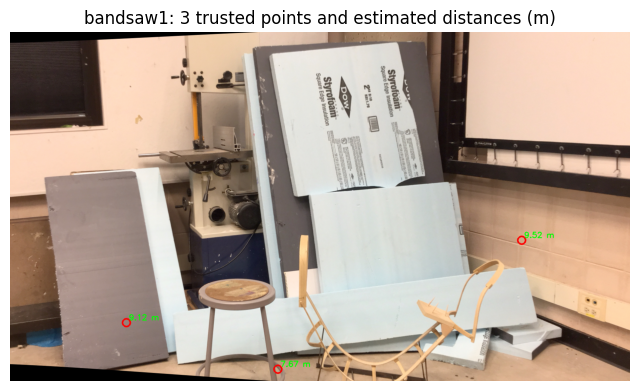

bandsaw2 - 3 trusted points and their distances (meter):
  Obje 1: (1183,1034) point's distance: 41.26 m
  Obje 2: (1190,1031) point's distance: 141.29 m
  Obje 3: (1190,1045) point's distance: 109.36 m


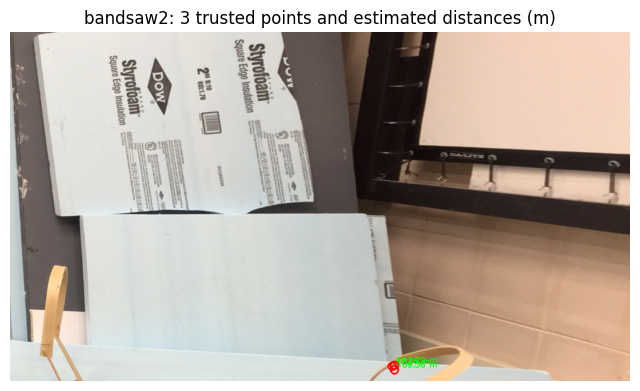

chess1 - 3 trusted points and their distances (meter):
  Obje 1: (1308,291) point's distance: 2.00 m
  Obje 2: (1237,356) point's distance: 2.14 m
  Obje 3: (620,683) point's distance: 2.83 m


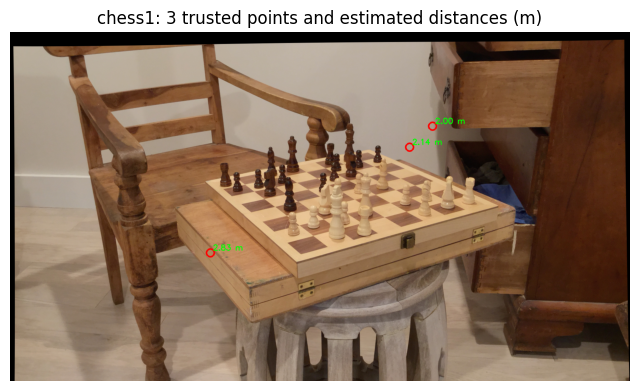

chess2 - 3 trusted points and their distances (meter):
  Obje 1: (270,1066) point's distance: 206.62 m
  Obje 2: (1719,629) point's distance: 2.50 m
  Obje 3: (1386,364) point's distance: 2.24 m


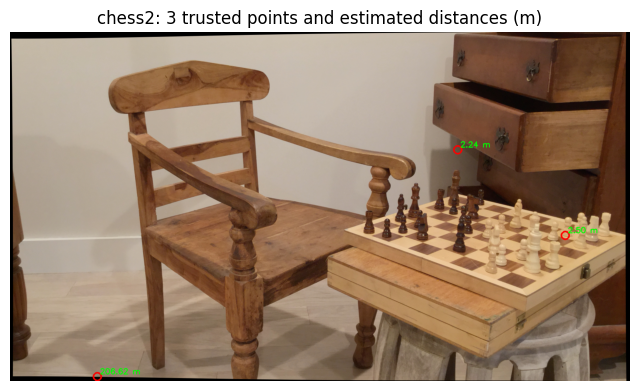

chess3 - 3 trusted points and their distances (meter):
  Obje 1: (532,798) point's distance: 1.85 m
  Obje 2: (636,305) point's distance: 2.35 m
  Obje 3: (1218,296) point's distance: 2.05 m


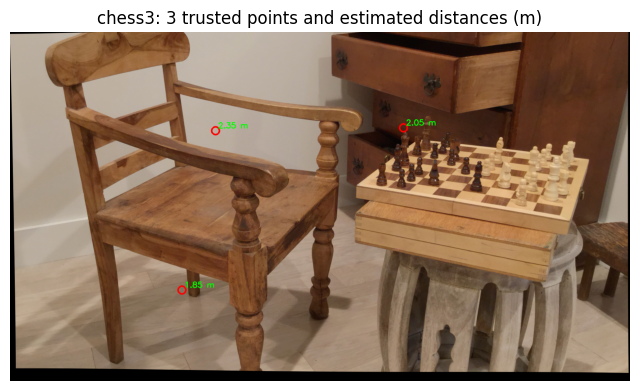

curule1 - 3 trusted points and their distances (meter):
  Obje 1: (1363,976) point's distance: 1.74 m
  Obje 2: (1241,221) point's distance: 2.33 m
  Obje 3: (1405,305) point's distance: 1.53 m


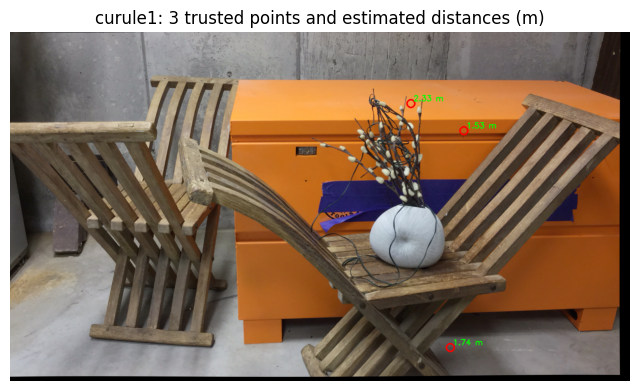

curule2 - 3 trusted points and their distances (meter):
  Obje 1: (468,230) point's distance: 1.79 m
  Obje 2: (1194,40) point's distance: 2.26 m
  Obje 3: (1812,177) point's distance: 2.26 m


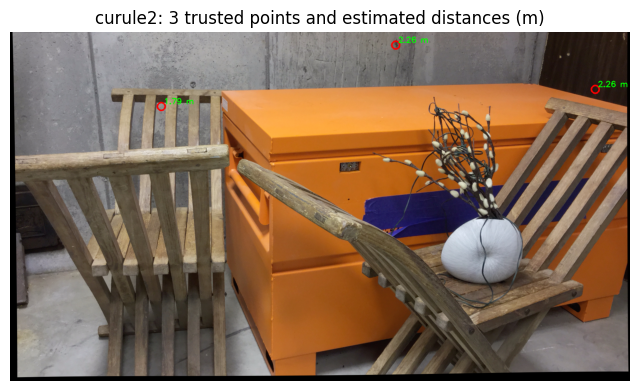

curule3 - 3 trusted points and their distances (meter):
  Obje 1: (1002,205) point's distance: 1.56 m
  Obje 2: (1853,654) point's distance: 2.41 m
  Obje 3: (905,1063) point's distance: 1.53 m


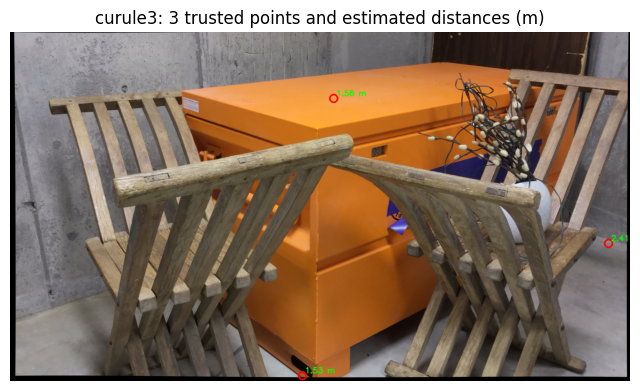

ladder1 - 3 trusted points and their distances (meter):
  Obje 1: (956,1853) point's distance: 6.38 m
  Obje 2: (924,1171) point's distance: 12.67 m
  Obje 3: (611,1567) point's distance: 8.10 m


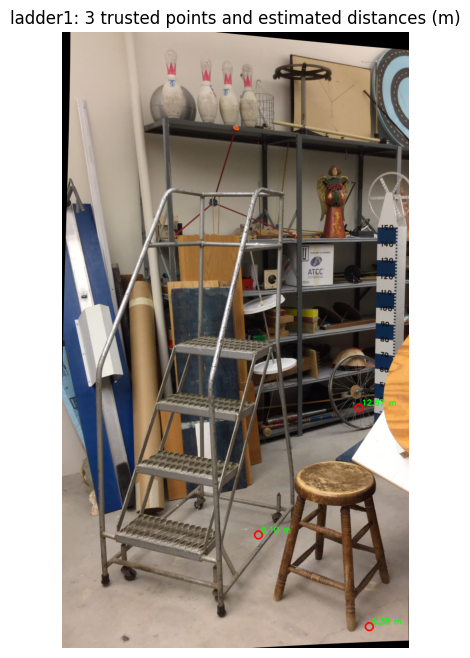

ladder2 - 3 trusted points and their distances (meter):
  Obje 1: (688,1755) point's distance: 6.19 m
  Obje 2: (437,1519) point's distance: 8.61 m
  Obje 3: (1023,885) point's distance: 9.25 m


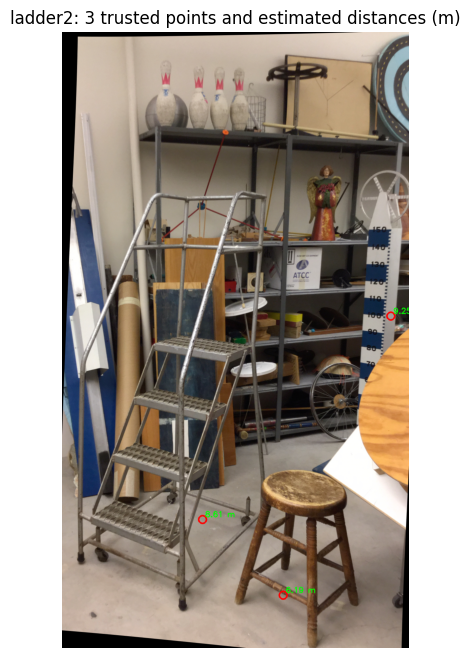

octogons1 - 3 trusted points and their distances (meter):
  Obje 1: (950,576) point's distance: 9.18 m
  Obje 2: (636,794) point's distance: 10.75 m
  Obje 3: (435,771) point's distance: 10.13 m


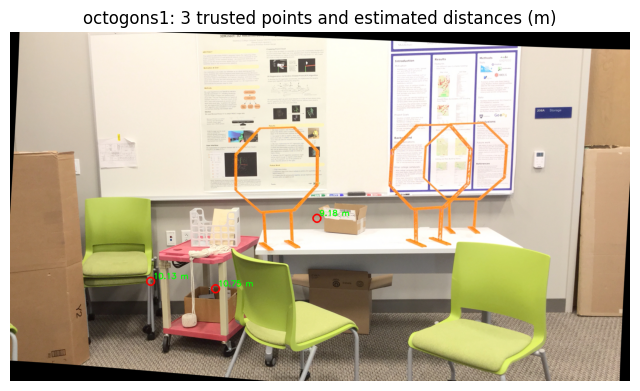

octogons2 - 3 trusted points and their distances (meter):
  Obje 1: (762,770) point's distance: 10.86 m
  Obje 2: (824,827) point's distance: 9.63 m
  Obje 3: (820,839) point's distance: 9.67 m


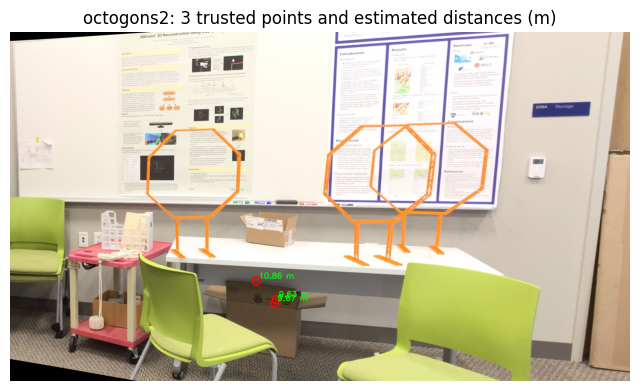

pendulum1 - 3 trusted points and their distances (meter):
  Obje 1: (1267,166) point's distance: 19.55 m
  Obje 2: (1317,990) point's distance: 9.61 m
  Obje 3: (413,635) point's distance: 9.70 m


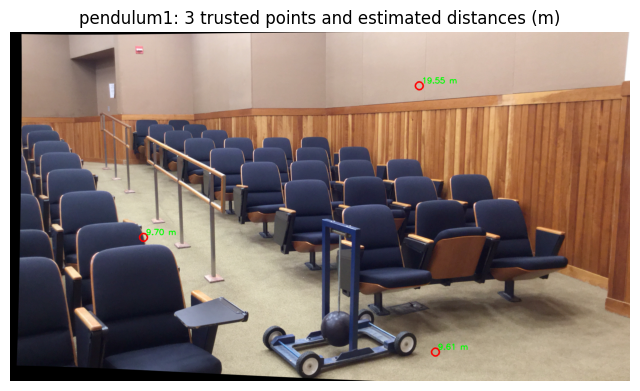

pendulum2 - 3 trusted points and their distances (meter):
  Obje 1: (1307,23) point's distance: 875.10 m
  Obje 2: (241,254) point's distance: 28.89 m
  Obje 3: (202,492) point's distance: 12.62 m


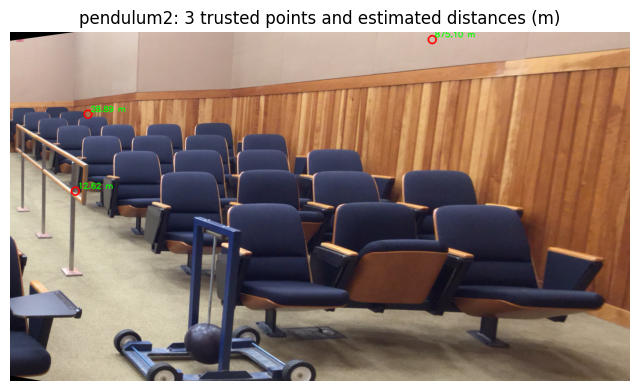

podium1 - 3 trusted points and their distances (meter):
  Obje 1: (1705,501) point's distance: 16.88 m
  Obje 2: (1288,192) point's distance: 15.13 m
  Obje 3: (1786,96) point's distance: 13.88 m


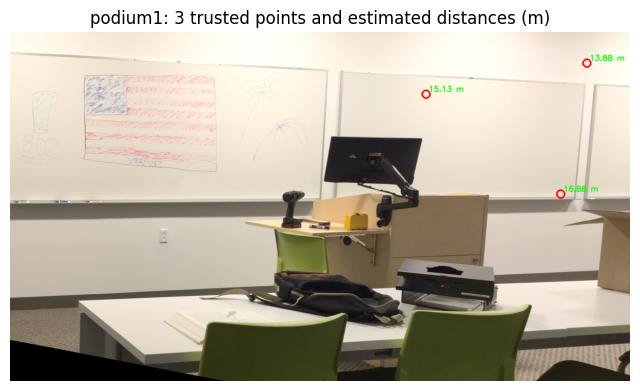

skates1 - 3 trusted points and their distances (meter):
  Obje 1: (1305,321) point's distance: 2.12 m
  Obje 2: (988,3) point's distance: 49.48 m
  Obje 3: (1209,181) point's distance: 2.13 m


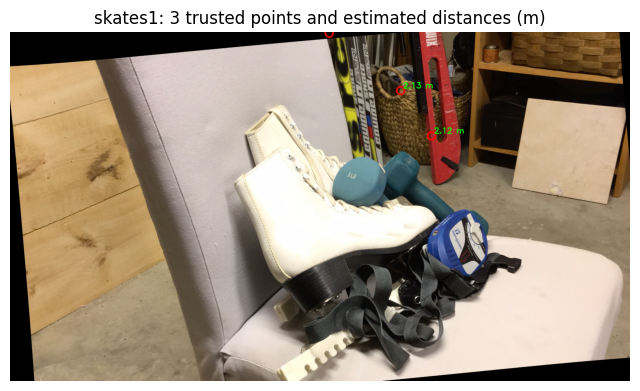

skates2 - 3 trusted points and their distances (meter):
  Obje 1: (1248,234) point's distance: 0.75 m
  Obje 2: (1048,197) point's distance: 0.81 m
  Obje 3: (312,696) point's distance: 2.03 m


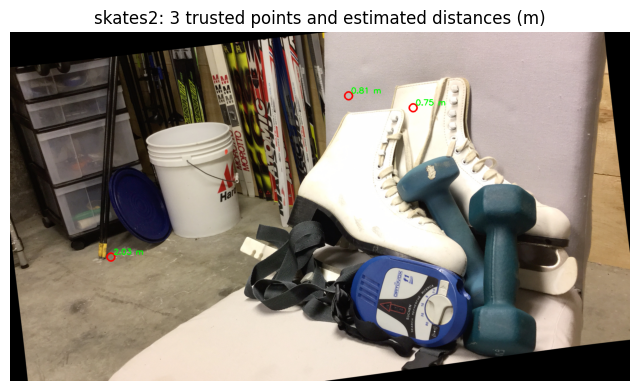

skiboots1 - 3 trusted points and their distances (meter):
  Obje 1: (499,473) point's distance: 1.65 m
  Obje 2: (470,408) point's distance: 1.61 m
  Obje 3: (394,462) point's distance: 1.59 m


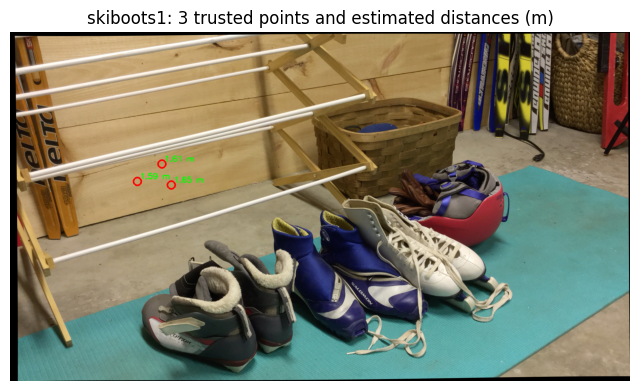

skiboots2 - 3 trusted points and their distances (meter):
  Obje 1: (450,443) point's distance: 10.21 m
  Obje 2: (1372,1061) point's distance: 44.94 m
  Obje 3: (1183,954) point's distance: 23.83 m


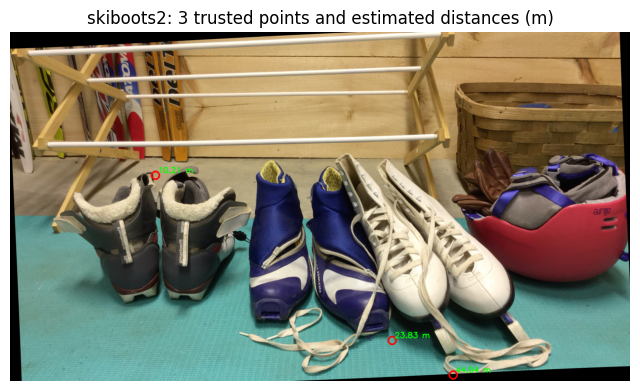

skiboots3 - 3 trusted points and their distances (meter):
  Obje 1: (1164,249) point's distance: 1.53 m
  Obje 2: (1191,193) point's distance: 1.49 m
  Obje 3: (1631,993) point's distance: 1.46 m


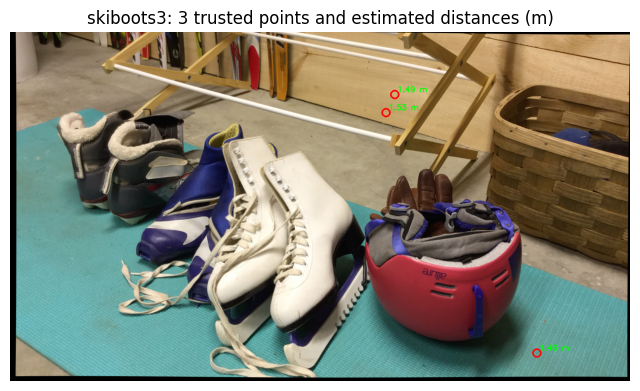

traproom1 - 3 trusted points and their distances (meter):
  Obje 1: (1869,384) point's distance: 34.27 m
  Obje 2: (1462,159) point's distance: 6.43 m
  Obje 3: (569,575) point's distance: 10.05 m


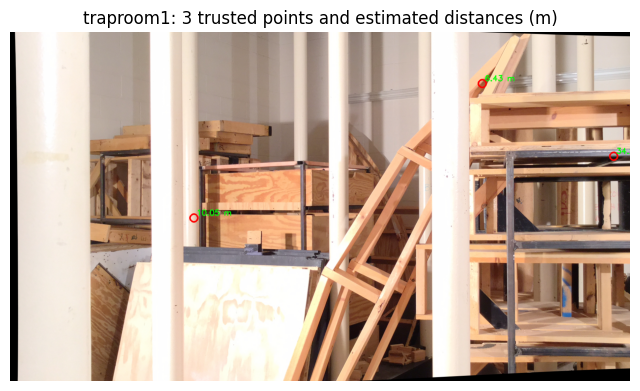

traproom2 - 3 trusted points and their distances (meter):
  Obje 1: (520,1042) point's distance: 9.35 m
  Obje 2: (1355,118) point's distance: 6.22 m
  Obje 3: (1483,43) point's distance: 6.34 m


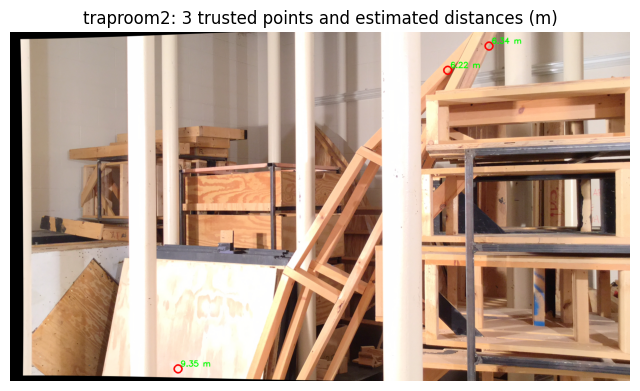

In [8]:
import random

base_dir = "data/"
scene_dirs = sorted([d for d in glob.glob(os.path.join(base_dir, "*")) if os.path.isdir(d)])

for scene_path in scene_dirs:
    scene_name = os.path.basename(scene_path)
    left_img_path = os.path.join(scene_path, "im0.png")
    right_img_path = os.path.join(scene_path, "im1.png")
    calib_file_path = os.path.join(scene_path, "calib.txt")

    if not (os.path.exists(left_img_path) and os.path.exists(right_img_path) and os.path.exists(calib_file_path)):
        print("file not found, skipping:", scene_name)
        continue

    # calibration
    with open(calib_file_path, "r") as f:
        lines = f.readlines()
        params = {}
        for line in lines:
            if "=" in line:
                key, value = line.strip().split("=")
                params[key.strip()] = value.strip()
    try:
        baseline = float(params["baseline"])
        cam0_values = params["cam0"].replace('[','').replace(']','').split()
        fx = float(cam0_values[0])
    except Exception as e:
        print("Failed to read calibration file:", e)
        continue

    # Görüntüler
    imgL = cv2.imread(left_img_path, cv2.IMREAD_COLOR)
    imgR = cv2.imread(right_img_path, cv2.IMREAD_COLOR)
    imgL_rgb = cv2.cvtColor(imgL, cv2.COLOR_BGR2RGB)
    imgL_gray = cv2.cvtColor(imgL, cv2.COLOR_BGR2GRAY)
    imgR_gray = cv2.cvtColor(imgR, cv2.COLOR_BGR2GRAY)

    # Disparity
    min_disp = 0
    num_disp = 192
    window_size = 9
    stereo = cv2.StereoSGBM_create(
        minDisparity=min_disp,
        numDisparities=num_disp,
        blockSize=window_size,
        P1=8*3*window_size**2,
        P2=32*3*window_size**2,
        mode=cv2.STEREO_SGBM_MODE_SGBM_3WAY
    )
    disparity = stereo.compute(imgL_gray, imgR_gray).astype(np.float32) / 16.0
    disparity[disparity <= 0] = 0.1

    depth = (baseline * fx) / disparity

    # find the most compatible disparity points
    valid_mask = (disparity > 1.0) & (disparity < 100.0)

    ys, xs = np.where(valid_mask)
    if len(xs) < 3:
        print(f"{scene_name} - insufficent disparity.")
        continue

    indices = random.sample(range(len(xs)), 3)
    points = [(xs[i], ys[i]) for i in indices]

    img_with_points = imgL_rgb.copy()
    print(f"{scene_name} - 3 trusted points and their distances (meter):")
    for idx, (x, y) in enumerate(points):
        d = disparity[y, x]
        z_mm = (baseline * fx) / d
        z_m = z_mm / 1000
        cv2.circle(img_with_points, (x, y), 12, (255, 0, 0), 3)
        cv2.putText(img_with_points, f"{z_m:.2f} m", (x+8, y-8), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0,255,0), 2)
        print(f"  Obje {idx+1}: ({x},{y}) point's distance: {z_m:.2f} m")

    plt.figure(figsize=(8,8))
    plt.imshow(img_with_points)
    plt.title(f"{scene_name}: 3 trusted points and estimated distances (m)")
    plt.axis("off")
    plt.show()
